# ASP Stereo Output Plotting

David Shean  
1/2/23

## To do:
* Integrate with the disparity plot notebook - remove x and y bias, show total magnitude

In [1]:
import os
import glob

import numpy as np
import matplotlib.pyplot as plt
from matplotlib_scalebar.scalebar import ScaleBar
from mpl_toolkits.axes_grid1 import make_axes_locatable
import rasterio as rio
from osgeo import gdal

In [2]:
from asp_plot_util import *

In [3]:
def plot_ar(im, ax, cmap='inferno', clim=None, clim_perc=(2,98), label=None, cbar=True, alpha=1):
    if clim is None:
        clim = get_clim(im, clim_perc)
    m = ax.imshow(im, cmap=cmap, clim=clim, alpha=alpha, interpolation='none')
    if cbar:
        divider = make_axes_locatable(ax)
        cax = divider.append_axes("right", size="4%", pad="2%")
        cb = plt.colorbar(m, cax=cax, ax=ax, extend=get_cbar_extend(im, clim))
        cax.set_ylabel(label)
    ax.set_facecolor("0.5")
    ax.set_xticks([])
    ax.set_yticks([])

### WIP: read match files to plot on orthoimages
Modified from `bare`: https://github.com/friedrichknuth/bare

In [8]:
def read_ip_record(mf):
    x, y = np.frombuffer(mf.read(8), dtype=np.float32)
    xi, yi = np.frombuffer(mf.read(8), dtype=np.int32)
    orientation, scale, interest = np.frombuffer(mf.read(12), dtype=np.float32)
    polarity, = np.frombuffer(mf.read(1), dtype=bool)
    octave, scale_lvl = np.frombuffer(mf.read(8), dtype=np.uint32)
    ndesc, = np.frombuffer(mf.read(8), dtype=np.uint64)
    desc = np.frombuffer(mf.read(int(ndesc * 4)), dtype=np.float32)
    iprec = [x, y, xi, yi, orientation, 
             scale, interest, polarity, 
             octave, scale_lvl, ndesc]
    iprec.extend(desc)
    return iprec


In [9]:
def read_match(fn):
    out_csv = os.path.splitext(fn)[0] + '.csv'
    with open(fn, 'rb') as mf, open(out_csv, 'w') as out:
        size1 = np.frombuffer(mf.read(8), dtype=np.uint64)[0]
        size2 = np.frombuffer(mf.read(8), dtype=np.uint64)[0]
        out.write('x1 y1 x2 y2\n')
        im1_ip = [read_ip_record(mf) for i in range(size1)]
        im2_ip = [read_ip_record(mf) for i in range(size2)]
        for i in range(len(im1_ip)):
            out.write('{} {} {} {}\n'.format(im1_ip[i][0], 
                                             im1_ip[i][1], 
                                             im2_ip[i][0], 
                                             im2_ip[i][1]))

In [10]:
# match_fn = '/Users/dshean/scr/BlackSky/GM_SnowOff_202208/stereo_nadirpinhole/BSG-118-20220818-144000-35576853__BSG-120-20220829-172023-36597228/BSG-118-20220818-144000-35576853__BSG-120-20220829-172023-36597228-L__R.match'
match_fn = '/Users/ben/Dropbox/UW_Shean/WV/2022/WV02_20220413_10300100D04DB500_10300100D0668800/stereo_ba_100ips_dg_pc_align__ortho_0.55m_mode_asp_mgm_spm_2_corr_7_rfne_15_cost_4_refdem_COP30/20220413_2202_10300100D04DB500_10300100D0668800-L__R.match'


In [11]:
read_match(match_fn)
#Plot ip and matches over L_sub and R_sub

## Stereo correlation plots

In [12]:
def plot_corr_results(outdir):
    f, axa = plt.subplots(3, 2, figsize=(7.5,10), dpi=220)
    axa = axa.ravel()

    l_img_fn = glob.glob(os.path.join(outdir, '*-L_sub.tif'))[0]
    #l_img_fn = glob.glob(os.path.join(outdir, '*-L.tif'))[0]
    l_img_ma = read_array(l_img_fn)

    r_img_fn = glob.glob(os.path.join(outdir, '*-R_sub.tif'))[0]
    #r_img_fn = glob.glob(os.path.join(outdir, '*-R.tif'))[0]
    r_img_ma = read_array(r_img_fn)
    
    disp_fn = glob.glob(os.path.join(outdir, '*-RD.tif'))[0]
    #disp_fn = glob.glob(os.path.join(outdir, '*-F.tif'))[0]
    dx_ma = read_array(disp_fn, 1)
    dy_ma = read_array(disp_fn, 2)
    disp_clim = find_common_clim(dx_ma, dy_ma, symm=True)
    
    l_stddev_fn = glob.glob(os.path.join(outdir, '*-L_stddev_filter_output.tif'))
    if l_stddev_fn:
        l_stddev_fn = l_stddev_fn[0]
        l_stddev_ma = read_array(l_stddev_fn)
        r_stddev_fn = glob.glob(os.path.join(outdir, '*-R_stddev_filter_output.tif'))[0]
        r_stddev_ma = read_array(r_stddev_fn)
        stddev_clim = list(find_common_clim(l_stddev_ma, r_stddev_ma))
        stddev_clim[0] = 0
        plot_ar(l_stddev_ma, ax=axa[2], clim=stddev_clim, cmap='inferno', label='std filter (px)')
        plot_ar(r_stddev_ma, ax=axa[3], clim=stddev_clim, cmap='inferno', label='std filter (px)')
    
    plot_ar(l_img_ma, ax=axa[0], cmap='gray', clim_perc=(0,100))
    plot_ar(r_img_ma, ax=axa[1], cmap='gray', clim_perc=(0,100))
    
    plot_ar(dx_ma, ax=axa[4], clim=disp_clim, cmap='RdBu', label='x disparity (px)')
    plot_ar(dy_ma, ax=axa[5], clim=disp_clim, cmap='RdBu', label='y disparity (px)')
    
    plt.suptitle(os.path.split(outdir)[-1])
    plt.tight_layout()
    out_fn = l_img_fn.split('-L.tif')[0]+'-corr_report.png'
    # plt.savefig(out_fn)
    #plt.close(f)

## Single pair DEM plots

In [22]:
def plot_dem(outdir, hillshade=True):
    f, axa = plt.subplots(1, 5, figsize=(20,5), dpi=300)
    axa = axa.ravel()

    ortho_fn = glob.glob(os.path.join(outdir, '*-L_sub.tif'))[0]
    # ortho_fn = outdir+'-L_sub.tif'
    #ortho_fn = glob.glob(os.path.join(outdir, '*-L_ortho.tif'))
    if ortho_fn:
        #ortho_fn = ortho_fn[0]
        ortho_ma = read_array(ortho_fn)
        plot_ar(ortho_ma, ax=axa[0], cmap='gray')
        axa[0].set_title('Left orthoimage')
    else:
        axa[0].axis('off')
 
    ortho_fn = glob.glob(os.path.join(outdir, '*-R_sub.tif'))[0]
    # ortho_fn = outdir+'-R_sub.tif'
    #ortho_fn = glob.glob(os.path.join(outdir, '*-R_ortho.tif'))
    if ortho_fn:
        #ortho_fn = ortho_fn[0]
        ortho_ma = read_array(ortho_fn)
        plot_ar(ortho_ma, ax=axa[1], cmap='gray')
        axa[1].set_title('Right orthoimage')
    else:
        axa[1].axis('off')
   
    
    dem_fn = glob.glob(os.path.join(outdir, '*-DEM_1m.tif'))[0]
    # dem_fn = outdir+'-DEM.tif'
    dem_ma = read_array(dem_fn)
    with rio.open(dem_fn) as ds:
        dem_gsd = ds.res[0]
    
    if hillshade:
        # hs_fn = glob.glob(os.path.join(outdir, '*-DEM_hs.tif'))
        hs_fn = os.path.splitext(dem_fn)[0]+'_hs.tif'
        if hs_fn:
            #hs_fn = hs_fn[0]
            hs_ma = read_array(hs_fn)
        else:
            dem_ds = gdal.Open(dem_fn)
            hs_ds = gdal.DEMProcessing('', dem_ds, 'hillshade', format='MEM', computeEdges=True)
            hs_ma = np.ma.masked_equal(hs_ds.ReadAsArray(), 0)
        plot_ar(hs_ma, ax=axa[2], cmap='gray', clim_perc=(5,95), cbar=False)
    
    #axa[4].set_title(os.path.split(dem_fn)[-1])
    plot_ar(dem_ma, ax=axa[2], cmap='viridis', label='Elevation (m HAE)', alpha=0.5)

    axa[2].set_title('Stereo DEM')
    scalebar = ScaleBar(dem_gsd)
    axa[2].add_artist(scalebar)
    
    #This is not generated by default (requires point2dem --errorimage)
    error_fn = glob.glob(os.path.join(outdir, '*-IntersectionErr.tif'))[0]
    # error_fn = outdir+'-IntersectionErr.tif'
    if error_fn:
        #error_fn = error_fn[0]
        error_ma = read_array(error_fn)
        plot_ar(error_ma, ax=axa[3], clim=get_clim(error_ma), cmap='inferno', label='Distance (m)')
        axa[3].set_title('Triangulation intersection error')
    else:
        axa[3].axis('off')
        
    
    #This is not generated by default (requires compute_diff.py $dem_fn $refdem)
    diff_fn = glob.glob(os.path.join(outdir, '*-DEM*diff.tif'))[0]
    # diff_fn = glob.glob(outdir+'-DEM*diff.tif')
    if diff_fn:
        diff_fn = diff_fn[0]
        diff_ma = read_array(diff_fn)
        #Note negative sign here, as these are DEM minus REF, and want REF minus DEM
        plot_ar(-diff_ma, ax=axa[4], clim=get_clim(diff_ma, symm=True), cmap='RdBu', label='Elevation diff. (m)')
        axa[4].set_title('DoD with reference')
    else:
        axa[4].axis('off')
    
    f.suptitle(os.path.split(dem_fn)[-1])
    f.tight_layout()
    out_fn = dem_fn.split('-DEM.tif')[0]+'-stereo_report.png'
    # plt.savefig(out_fn, bbox_inches='tight')
    #plt.close(f)

## Testing

In [23]:
outdir = '/Users/ben/Dropbox/UW_Shean/WV/2022/WV02_20220413_10300100D04DB500_10300100D0668800/stereo_ba_100ips_dg_pc_align__ortho_0.55m_mode_asp_mgm_spm_2_corr_7_rfne_15_cost_4_refdem_COP30/'

RasterioIOError: '/' not recognized as a supported file format.

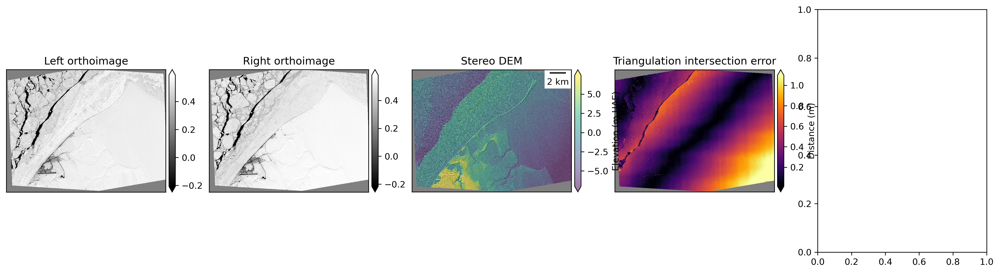

In [24]:
plot_dem(outdir)

ERROR 4: /Users/ben/Dropbox/UW_Shean/WV/2022/WV02_20220413_10300100D04DB500_10300100D0668800/stereo_ba_100ips_dg_pc_align__ortho_0.55m_mode_asp_mgm_spm_2_corr_7_rfne_15_cost_4_refdem_COP30/20220413_2202_10300100D04DB500_10300100D0668800-1024_0_1024_1024/1024_0_1024_1024-RD.tif: No such file or directory


RasterioIOError: Read or write failed. /Users/ben/Dropbox/UW_Shean/WV/2022/WV02_20220413_10300100D04DB500_10300100D0668800/stereo_ba_100ips_dg_pc_align__ortho_0.55m_mode_asp_mgm_spm_2_corr_7_rfne_15_cost_4_refdem_COP30/20220413_2202_10300100D04DB500_10300100D0668800-1024_0_1024_1024/1024_0_1024_1024-RD.tif: No such file or directory

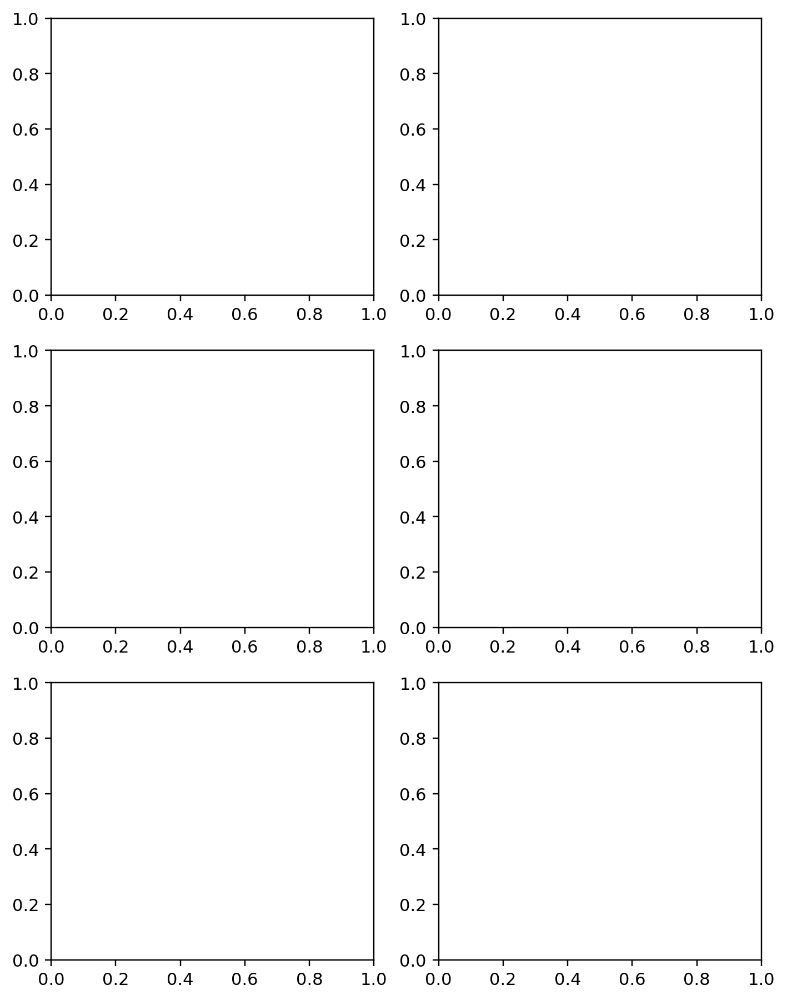

In [25]:
plot_corr_results(outdir)

In [32]:
outdir = '/Users/dshean/scr/utqiagvik/WV02_20220411_10300100D102A400_10300100D1B7D600/ncc_dgmaprpc/'
outdir = '/Users/dshean/scr/utqiagvik/WV02_20220411_10300100D102A400_10300100D1B7D600/bm_crop/bm_crop_filt_147px_100px'

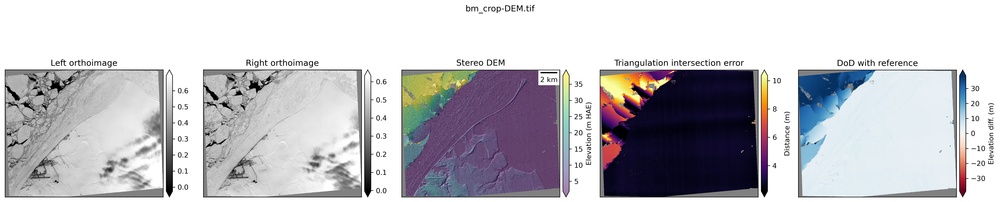

In [36]:
plot_dem('/Users/dshean/scr/utqiagvik/WV02_20220411_10300100D102A400_10300100D1B7D600/bm_crop/bm_crop')

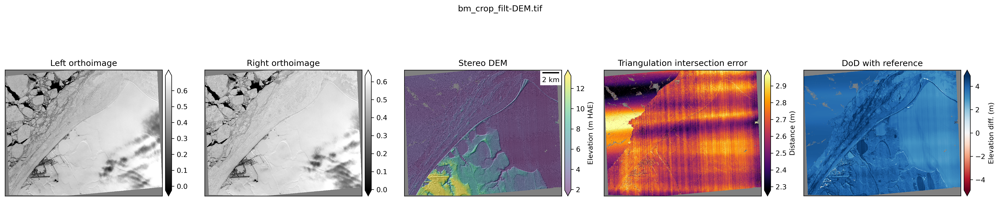

In [37]:
plot_dem('/Users/dshean/scr/utqiagvik/WV02_20220411_10300100D102A400_10300100D1B7D600/bm_crop/bm_crop_filt')

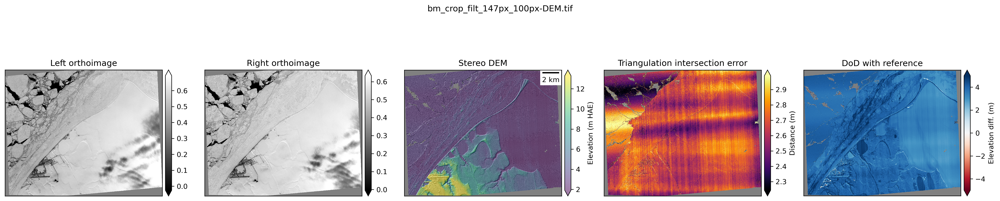

In [38]:
plot_dem('/Users/dshean/scr/utqiagvik/WV02_20220411_10300100D102A400_10300100D1B7D600/bm_crop/bm_crop_filt_147px_100px')
#plot_corr_results(outdir)